# Introduction

In this project, we are interested in developing a model that can create images that resemble paintings in the style of Monet. We will train our model using a data set consisting of a collection of scans of actual Monet paintings and a collection of photos. The cell below imports the libraries, functions, and classes that we need and sets up the runtime environment for the use of TensorFlow.

In [1]:
import os
import numpy as np
import pandas as pd
from cv2 import imread
import matplotlib.pyplot as plt
import tensorflow as tf
import keras
from keras import layers, ops
import zipfile
from PIL import Image

autotune = tf.data.AUTOTUNE
os.environ["KERAS_BACKEND"] = "tensorflow"

# Data exploration

Below, we specify the directories for our photos and Monet scans and generate a list with all the paths and filenames for those images.

In [2]:
monet_jpg_directory = "/kaggle/input/gan-getting-started/monet_jpg"
photo_jpg_directory = "/kaggle/input/gan-getting-started/photo_jpg"

In [3]:
def getImagePaths(path):
    image_names = []
    for dirname, _, filenames in os.walk(path):
        for filename in filenames:
            fullpath = os.path.join(dirname, filename)
            image_names.append(fullpath)
    return image_names

In [4]:
monet_images_path = getImagePaths(monet_jpg_directory)
photo_images_path = getImagePaths(photo_jpg_directory)
print(f"Number of Monet images: {len(monet_images_path)}")
print(f"Number of Photo images: {len(photo_images_path)}")

Number of Monet images: 300
Number of Photo images: 7038


We have 300 Monet scans and 7038 photos. Next we inspect the dimensions and color compositions of the files.

In [5]:
df_monet = pd.DataFrame({"path": monet_images_path})
df_photo = pd.DataFrame({"path": photo_images_path})
df = pd.concat([df_monet, df_photo])
df["x"] = np.zeros((df.shape[0],1))
df["y"] = np.zeros((df.shape[0],1))
df["z"] = np.zeros((df.shape[0],1))
df["mean_r"] = np.zeros((df.shape[0],1))
df["mean_g"] = np.zeros((df.shape[0],1))
df["mean_b"] = np.zeros((df.shape[0],1))
for i in range(df.shape[0]): 
    file = df.iloc[i,0]
    img = imread(file)
    df.iloc[i,1] = img.shape[0]
    df.iloc[i,2] = img.shape[1]
    df.iloc[i,3] = img.shape[2]
    df.iloc[i,4] = img[:,:,0].mean()
    df.iloc[i,5] = img[:,:,1].mean()
    df.iloc[i,6] = img[:,:,2].mean()

In [6]:
df.loc[:,["x","y","z"]].describe()

,x,y,z
count,7338.0,7338.0,7338.0
mean,256.0,256.0,3.0
std,0.0,0.0,0.0
min,256.0,256.0,3.0
25%,256.0,256.0,3.0
50%,256.0,256.0,3.0
75%,256.0,256.0,3.0
max,256.0,256.0,3.0


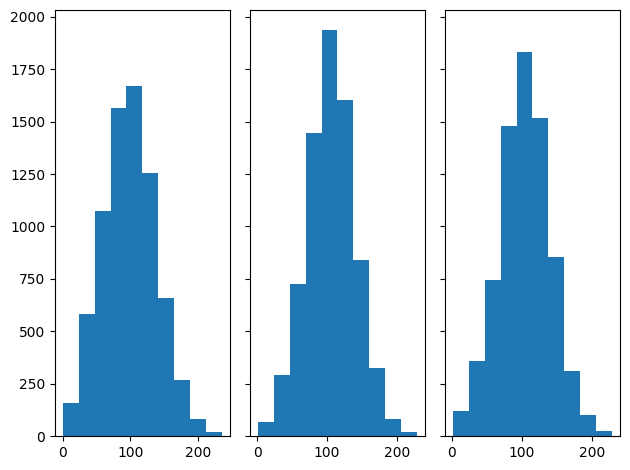

In [7]:
fig, axs = plt.subplots(1, 3, sharey=True, tight_layout=True)
axs[0].hist(df["mean_r"])
axs[1].hist(df["mean_g"])
axs[2].hist(df["mean_b"])
plt.show()

Summary statistics for the dimensional data shows that all the images are $256 \times 256$ pixels with three color chanels. Histograms of the average values for each color channel in each image show approximately normal distributions concentrated in the interval 
$[0,255]$, as we expect for image files.

Our exploratory data analysis suggests that the image data for this project is already very clean, so we can proceed to preprocessing.

# Preprocessing

Our plan of analysis is as follows.

1. **Train a CycleGAN.** The CycleGAN will include generators that translate photos into Monet-style images and vice versa. 
2. **Tune hyperparameters.** Implementing the CycleGAN with more or fewer filters in its generator will increase or decrease training time. Test the size of this effect as well as how the number of filters affects the quality of the generated Monet images.
3. **Test other architectures.** In particular, test whether a simplified GAN with only one generator can 

Since the image data is already fairly clean, we will start with minimal preprocessing consisting of transforming each image into a tensor and normalizing the color values to lie in $[-1,1]$. The following cell defines a function to perform this step.

In [8]:
def preprocess_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.cast(image, tf.float32)
    image = (image / 127.5) - 1
    return image

Next, we apply the preprocessing function to the Monet and photo images and then sort those images into batches.

In [9]:
monet_ds = tf.data.Dataset.from_tensor_slices(monet_images_path)
monet_ds = monet_ds.map(preprocess_image, num_parallel_calls=autotune)
photo_ds = tf.data.Dataset.from_tensor_slices(photo_images_path)
photo_ds = photo_ds.map(preprocess_image, num_parallel_calls=autotune)
BATCH_SIZE = 1
monet_ds = monet_ds.cache().shuffle(1000).batch(BATCH_SIZE).prefetch(autotune)
photo_ds = photo_ds.cache().shuffle(1000).batch(BATCH_SIZE).prefetch(autotune)

The next cell sets values to be used by TensorFlow during training.

In [10]:
input_img_size = (256, 256, 3)
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

Finally, we check the preprocessing by rendering a few image tensors as images.

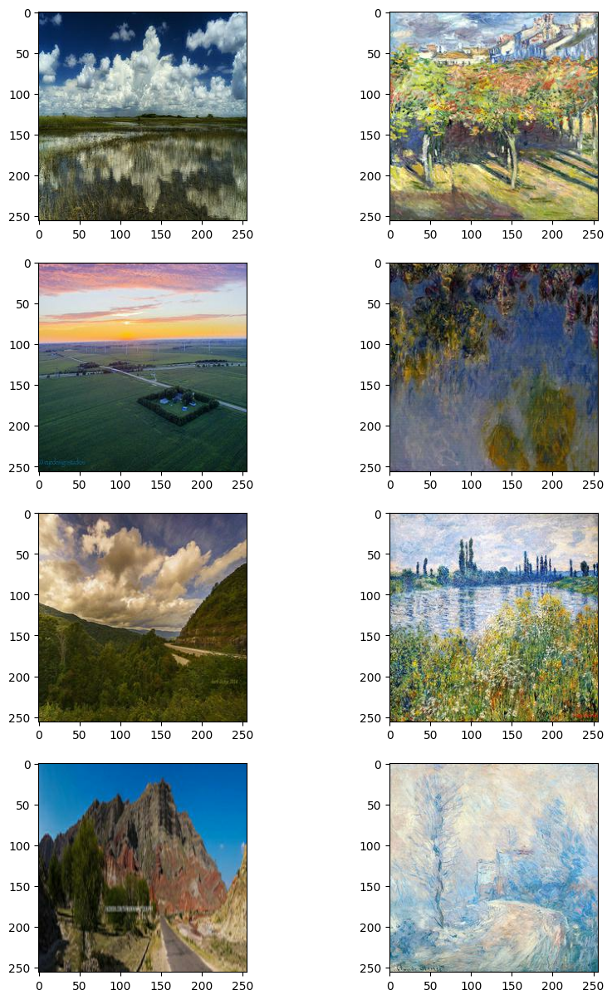

In [11]:
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, samples in enumerate(zip(photo_ds.take(4), monet_ds.take(4))):
    photo = (((samples[0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    monet = (((samples[1][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    ax[i, 0].imshow(photo)
    ax[i, 1].imshow(monet)
plt.show()

# CycleGAN model building

The machine learning task for this project is an instance of image-to-image translation, and our training data consists of unpaired images (i.e., no particular photo corresponds to any particular Monet painting and vice versa). For this kind of task with this kind of data, a cyclic generative adversarial network (CycleGAN) can be an effective deep learning architecture. A CycleGAN built to learn image translation from domain A to domain B consists of two generator-discriminator pairs. In each pair, the generator attempts to translate images from one domain to the other, and the discriminator attempts to distinguish between translated images and and genuine images. If the generators in a CycleGAN are well-trained, then translating an image from one domain to another and then back again should result in an image that the discriminator for the first domain recognizes as genuine. Therefore, besides the adversarial loss functions used by other generative adversarial networks, CycleGANS also include consistency loss functions to measure model performance with respect to "there and back again" translation.

The CycleGAN implementation below is from a Keras tutorial available at [https://keras.io/examples/generative/cyclegan/](https://keras.io/examples/generative/cyclegan/).

In [12]:
class ReflectionPadding2D(layers.Layer):
    """Implements Reflection Padding as a layer.

    Args:
        padding(tuple): Amount of padding for the
        spatial dimensions.

    Returns:
        A padded tensor with the same type as the input tensor.
    """

    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        super().__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        return ops.pad(input_tensor, padding_tensor, mode="REFLECT")

In [13]:
def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = keras.layers.GroupNormalization(
        groups=1, 
        gamma_initializer=gamma_initializer
    )(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = keras.layers.GroupNormalization(
        groups=1, 
        gamma_initializer=gamma_initializer
    )(x)
    x = layers.add([input_tensor, x])
    return x

In [14]:
def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = keras.layers.GroupNormalization(
        groups=1, 
        gamma_initializer=gamma_initializer
    )(x)
    if activation:
        x = activation(x)
    return x

In [15]:
def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = keras.layers.GroupNormalization(
        groups=1, 
        gamma_initializer=gamma_initializer
    )(x)
    if activation:
        x = activation(x)
    return x

In [16]:
def get_resnet_generator(
    filters=64,
    num_downsampling_blocks=2,
    num_residual_blocks=9,
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = ReflectionPadding2D(padding=(3, 3))(img_input)
    x = layers.Conv2D(
        filters, 
        (7, 7), 
        kernel_initializer=kernel_init, 
        use_bias=False
    )(x)
    x = keras.layers.GroupNormalization(
        groups=1, 
        gamma_initializer=gamma_initializer
    )(x)
    x = layers.Activation("relu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(
            x, 
            filters=filters, 
            activation=layers.Activation("relu")
        )

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("relu"))

    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("relu"))

    # Final block
    x = ReflectionPadding2D(padding=(3, 3))(x)
    x = layers.Conv2D(3, (7, 7), padding="valid")(x)
    x = layers.Activation("tanh")(x)

    model = keras.models.Model(img_input, x, name=name)
    return model

In [17]:
def get_discriminator(
    filters=64, 
    kernel_initializer=kernel_init, 
    num_downsampling=3, 
    name=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = layers.Conv2D(
        filters,
        (4, 4),
        strides=(2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(img_input)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(1, 1),
            )

    x = layers.Conv2D(
        1, 
        (4, 4), 
        strides=(1, 1), 
        padding="same", 
        kernel_initializer=kernel_initializer
    )(x)

    model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    return model

In [18]:
class CycleGan(keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super().__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def call(self, inputs):
        return (
            self.disc_X(inputs),
            self.disc_Y(inputs),
            self.gen_G(inputs),
            self.gen_F(inputs),
        )

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super().compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        # x is photo and y is monet
        real_x, real_y = batch_data

        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adversarial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
            # photo to fake monet
            fake_y = self.gen_G(real_x, training=True)
            # monet to fake photo -> y2x
            fake_x = self.gen_F(real_y, training=True)

            # Cycle (photo to fake monet to fake photo): x -> y -> x
            cycled_x = self.gen_F(fake_y, training=True)
            # Cycle (monet to fake photo to fake monet) y -> x -> y
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adversarial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            # Generator identity loss
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }

In [19]:
class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(1, 2, figsize=(12, 12))
        for i, img in enumerate(photo_ds.take(self.num_img)):
            prediction = self.model.gen_G(img)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

            ax[0].imshow(img)
            ax[1].imshow(prediction)
            ax[0].set_title("Input image")
            ax[1].set_title("Translated image")
            ax[0].axis("off")
            ax[1].axis("off")

            prediction = keras.utils.array_to_img(prediction)
            prediction.save(
                "generated_img_{i}_{epoch}.png".format(i=i, epoch=epoch + 1)
            )
        plt.show()
        plt.close()

In [20]:
# Instantiate loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(ops.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(ops.ones_like(real), real)
    fake_loss = adv_loss_fn(ops.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5

# Model training

The following cells initialize generators and discriminators and use them to construct a CycleGAN model. The model is trained over 30 epochs using a custom callback `GANMonitor` (which was also from the Keras tutorial implementation). This callback uses the Monet generator to create an image from a random photo. This way, we can inspect the model's evolution visually.

In [21]:
# Set the number of filters
num_filters = 16

# Get the generators
gen_G = get_resnet_generator(filters=num_filters, name="generator_G")
gen_F = get_resnet_generator(filters=num_filters, name="generator_F")

# Get the discriminators
disc_X = get_discriminator(filters=num_filters, name="discriminator_X")
disc_Y = get_discriminator(filters=num_filters, name="discriminator_Y")

Epoch 1/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - D_X_loss: 0.0772 - D_Y_loss: 0.0646 - F_loss: 6.3200 - G_loss: 6.1179

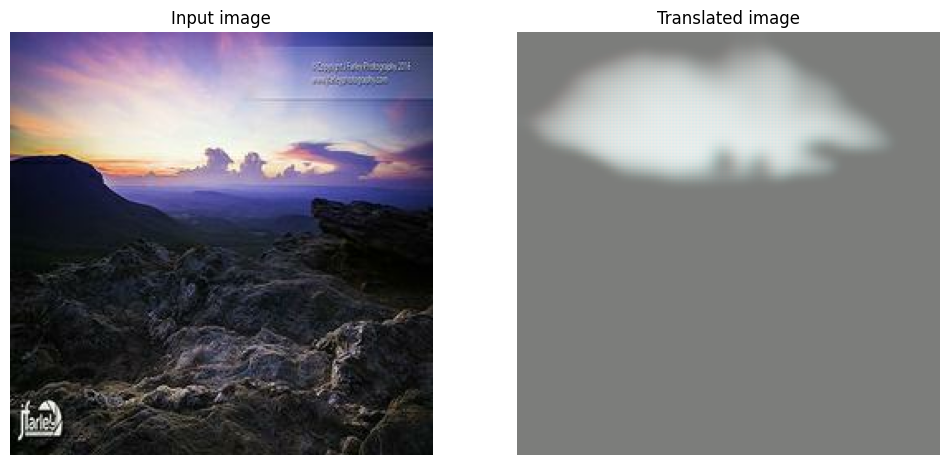

300/300 ━━━━━━━━━━━━━━━━━━━━ 194s 80ms/step - D_X_loss: 0.0770 - D_Y_loss: 0.0644 - F_loss: 6.3194 - G_loss: 6.1170
Epoch 2/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - D_X_loss: 0.0354 - D_Y_loss: 0.0877 - F_loss: 5.3588 - G_loss: 4.7116

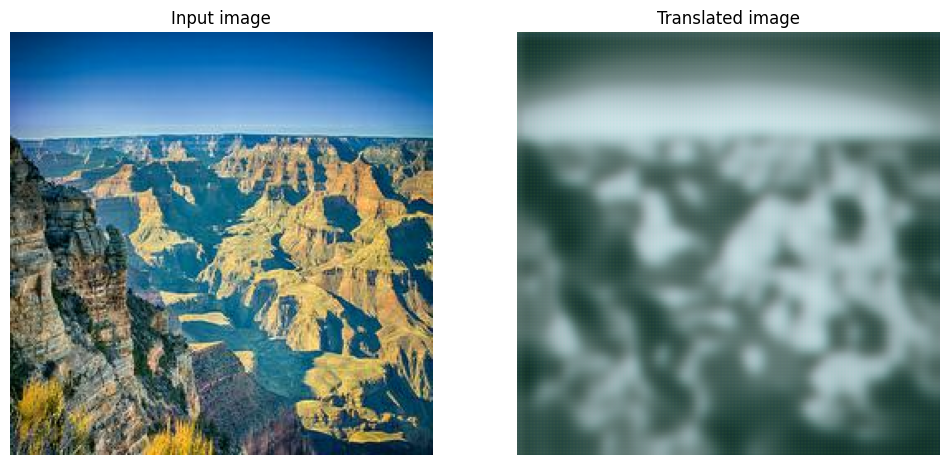

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 77ms/step - D_X_loss: 0.0354 - D_Y_loss: 0.0885 - F_loss: 5.3597 - G_loss: 4.7084
Epoch 3/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - D_X_loss: 0.0450 - D_Y_loss: 0.0580 - F_loss: 4.1944 - G_loss: 4.0604

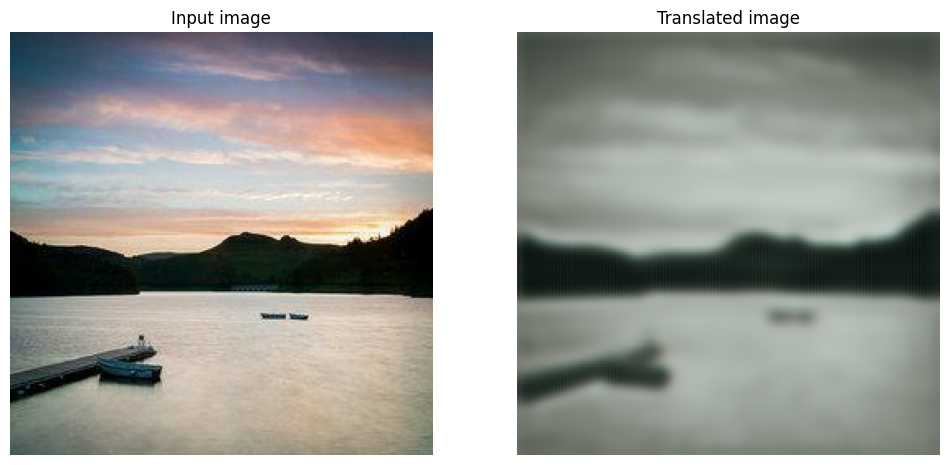

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 78ms/step - D_X_loss: 0.0448 - D_Y_loss: 0.0578 - F_loss: 4.1953 - G_loss: 4.0609
Epoch 4/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - D_X_loss: 0.0533 - D_Y_loss: 0.1018 - F_loss: 4.0741 - G_loss: 3.8074

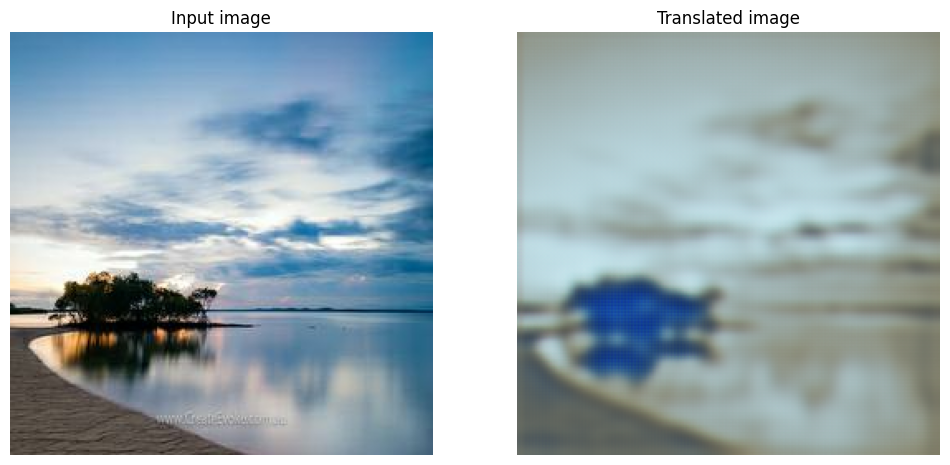

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 79ms/step - D_X_loss: 0.0534 - D_Y_loss: 0.1027 - F_loss: 4.0741 - G_loss: 3.8037
Epoch 5/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.0525 - D_Y_loss: 0.1470 - F_loss: 4.0012 - G_loss: 3.7135

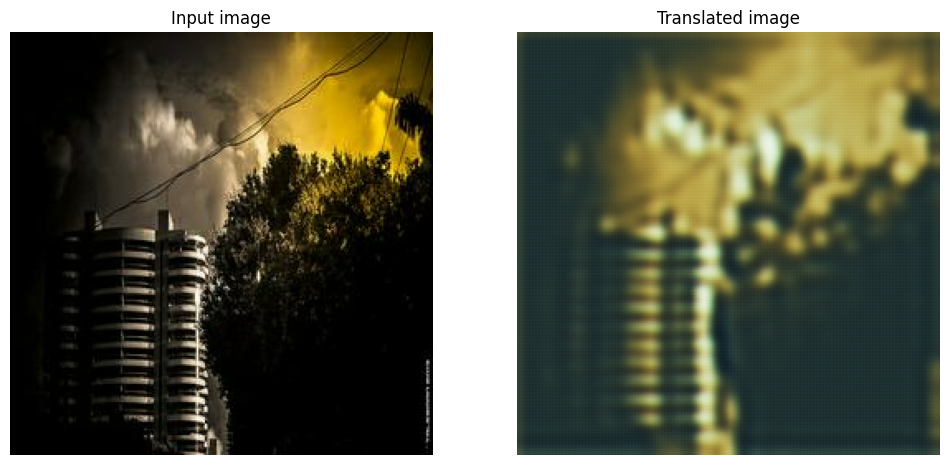

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 79ms/step - D_X_loss: 0.0523 - D_Y_loss: 0.1470 - F_loss: 4.0001 - G_loss: 3.7107
Epoch 6/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.0694 - D_Y_loss: 0.1131 - F_loss: 3.9645 - G_loss: 3.7232

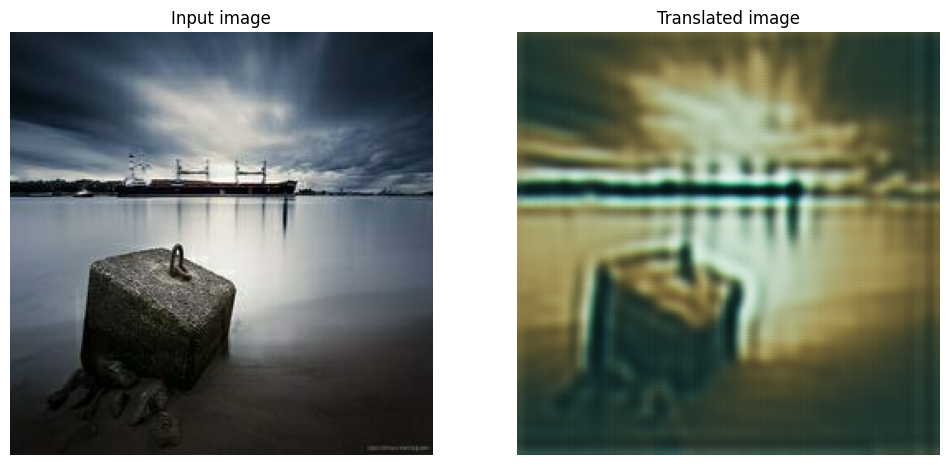

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 80ms/step - D_X_loss: 0.0710 - D_Y_loss: 0.1129 - F_loss: 3.9676 - G_loss: 3.7233
Epoch 7/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1621 - D_Y_loss: 0.0905 - F_loss: 3.6870 - G_loss: 3.7634

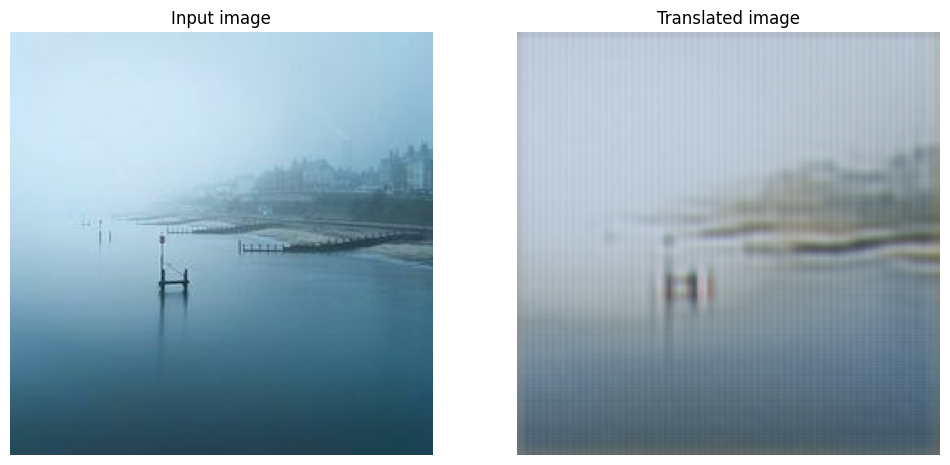

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 80ms/step - D_X_loss: 0.1620 - D_Y_loss: 0.0902 - F_loss: 3.6844 - G_loss: 3.7677
Epoch 8/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1660 - D_Y_loss: 0.1117 - F_loss: 3.6873 - G_loss: 3.7687

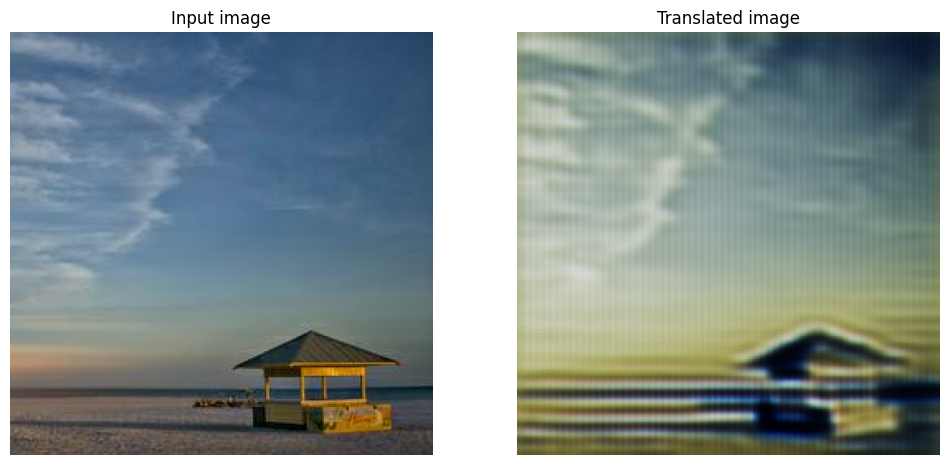

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 79ms/step - D_X_loss: 0.1656 - D_Y_loss: 0.1114 - F_loss: 3.6908 - G_loss: 3.7651
Epoch 9/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1707 - D_Y_loss: 0.1441 - F_loss: 3.3166 - G_loss: 3.4478

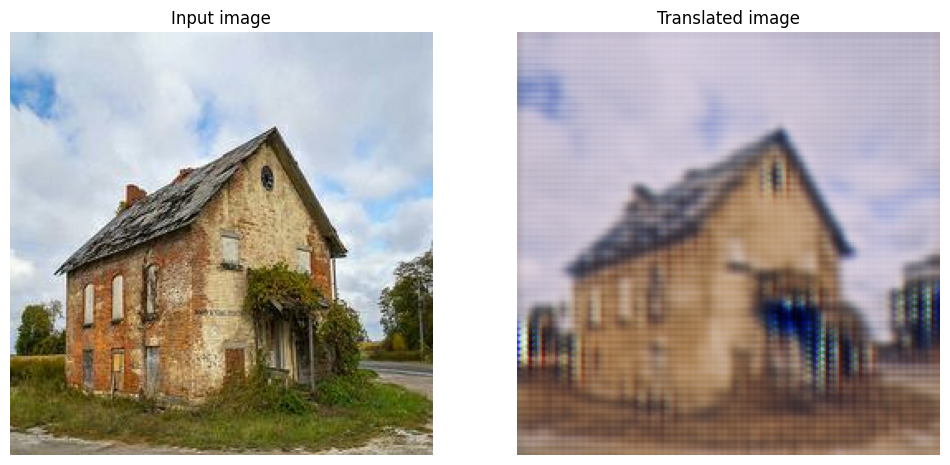

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1715 - D_Y_loss: 0.1436 - F_loss: 3.3166 - G_loss: 3.4491
Epoch 10/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1599 - D_Y_loss: 0.0962 - F_loss: 2.9793 - G_loss: 3.3146

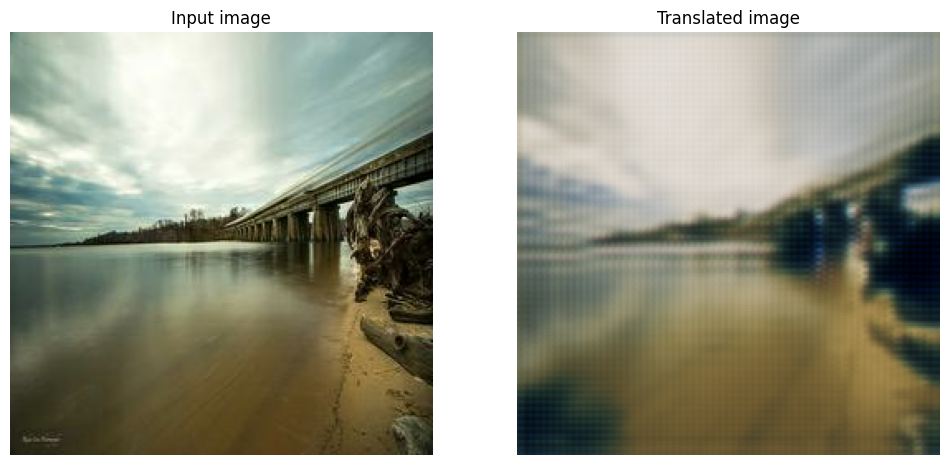

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 81ms/step - D_X_loss: 0.1604 - D_Y_loss: 0.0967 - F_loss: 2.9777 - G_loss: 3.3124
Epoch 11/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1376 - D_Y_loss: 0.0968 - F_loss: 3.0906 - G_loss: 3.2081

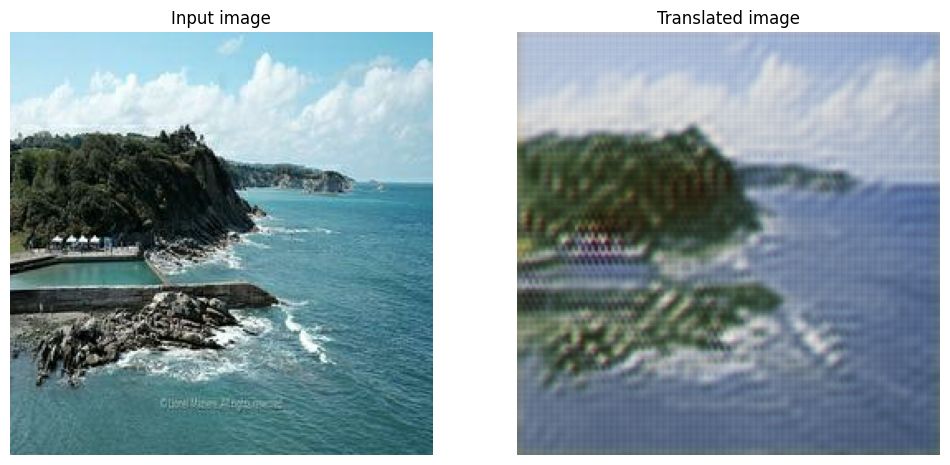

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1383 - D_Y_loss: 0.0965 - F_loss: 3.0900 - G_loss: 3.2087
Epoch 12/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1205 - D_Y_loss: 0.1470 - F_loss: 3.0687 - G_loss: 3.0557

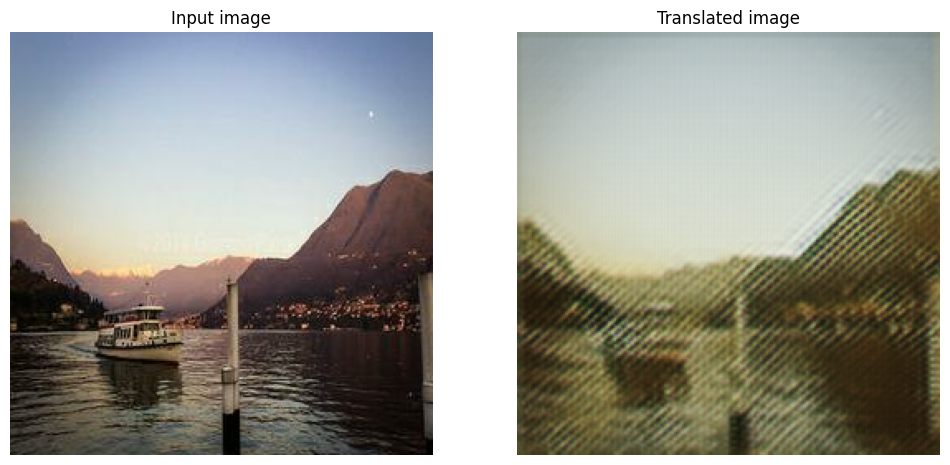

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1202 - D_Y_loss: 0.1469 - F_loss: 3.0679 - G_loss: 3.0564
Epoch 13/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1330 - D_Y_loss: 0.1701 - F_loss: 2.9318 - G_loss: 2.7956

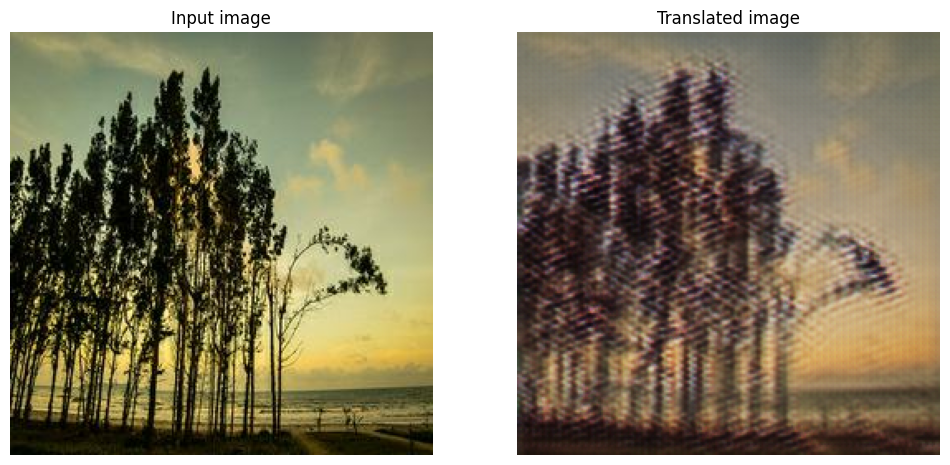

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1326 - D_Y_loss: 0.1697 - F_loss: 2.9327 - G_loss: 2.7960
Epoch 14/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1040 - D_Y_loss: 0.1177 - F_loss: 3.0024 - G_loss: 2.8930

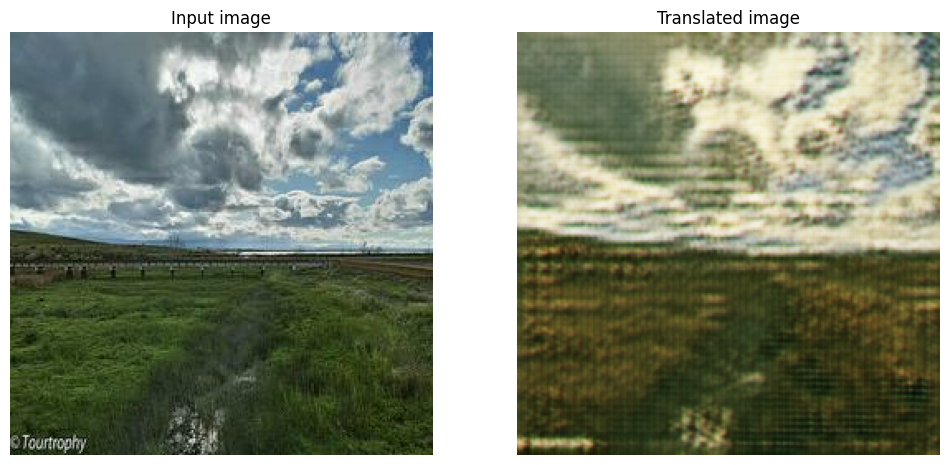

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1043 - D_Y_loss: 0.1190 - F_loss: 3.0132 - G_loss: 2.8959
Epoch 15/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1388 - D_Y_loss: 0.1669 - F_loss: 2.9868 - G_loss: 2.8461

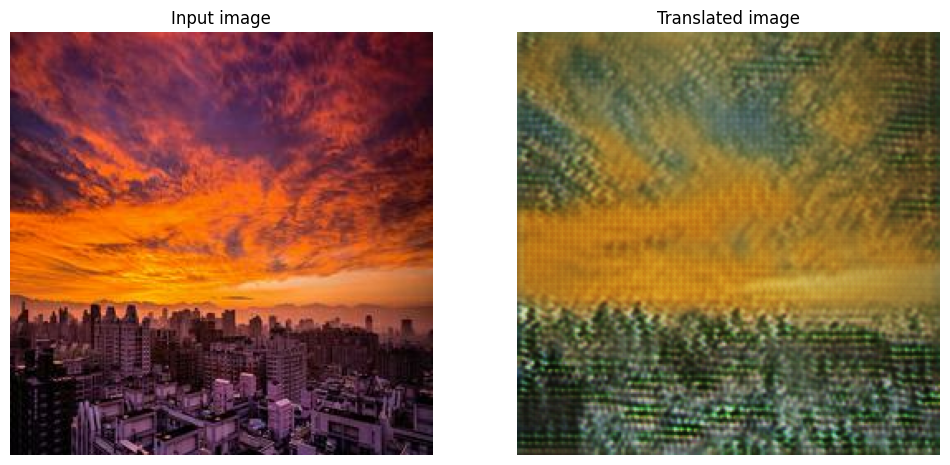

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1384 - D_Y_loss: 0.1669 - F_loss: 2.9887 - G_loss: 2.8469
Epoch 16/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1631 - D_Y_loss: 0.1379 - F_loss: 2.8123 - G_loss: 2.8037

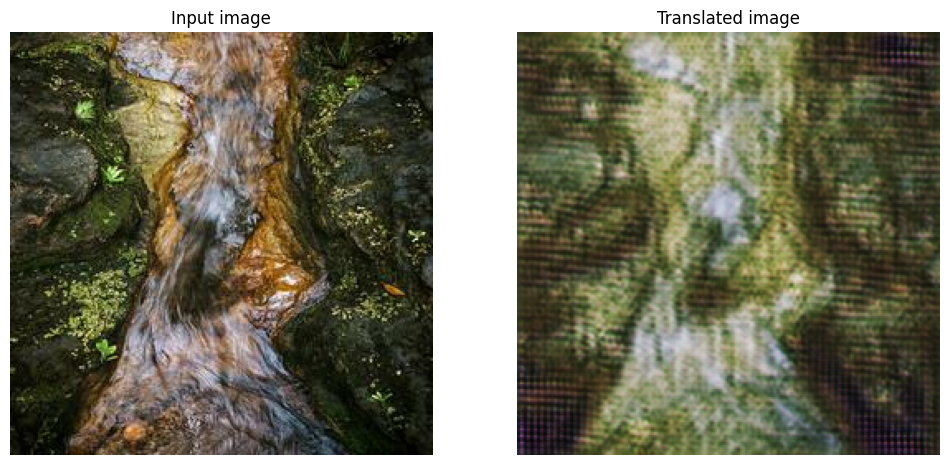

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 81ms/step - D_X_loss: 0.1632 - D_Y_loss: 0.1381 - F_loss: 2.8124 - G_loss: 2.8060
Epoch 17/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1811 - D_Y_loss: 0.1420 - F_loss: 2.6953 - G_loss: 2.8735

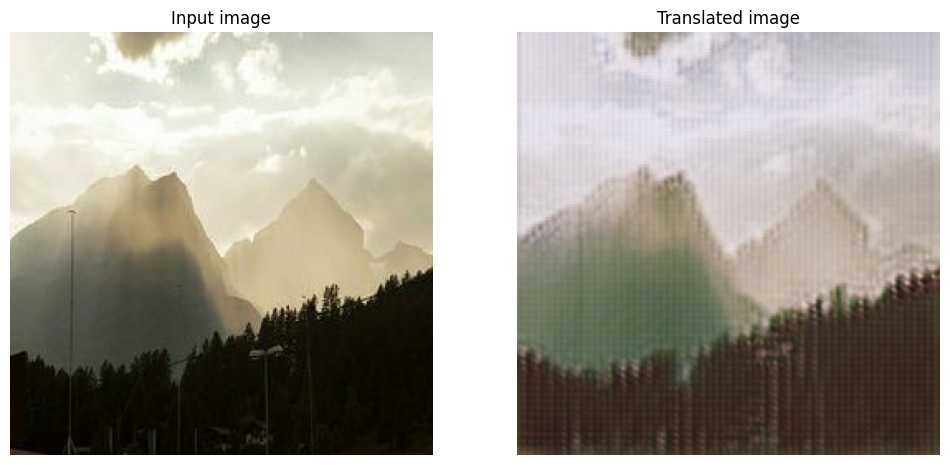

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1810 - D_Y_loss: 0.1417 - F_loss: 2.6971 - G_loss: 2.8734
Epoch 18/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1456 - D_Y_loss: 0.1503 - F_loss: 2.8567 - G_loss: 2.8169

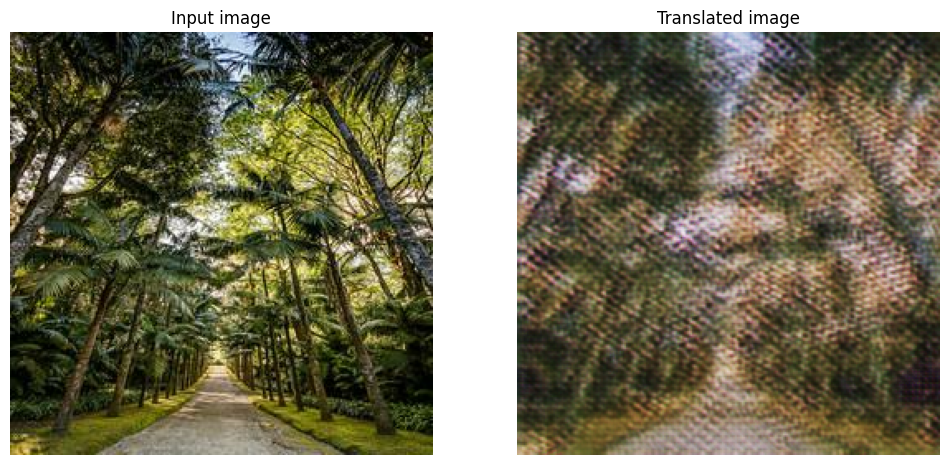

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 80ms/step - D_X_loss: 0.1455 - D_Y_loss: 0.1510 - F_loss: 2.8563 - G_loss: 2.8163
Epoch 19/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1269 - D_Y_loss: 0.1654 - F_loss: 2.7864 - G_loss: 2.7411

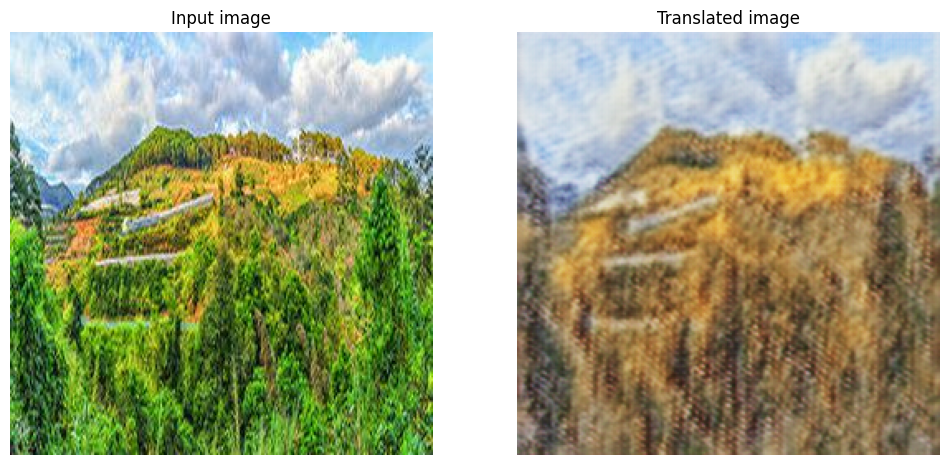

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 81ms/step - D_X_loss: 0.1267 - D_Y_loss: 0.1650 - F_loss: 2.7864 - G_loss: 2.7437
Epoch 20/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1480 - D_Y_loss: 0.1642 - F_loss: 2.7125 - G_loss: 2.7197

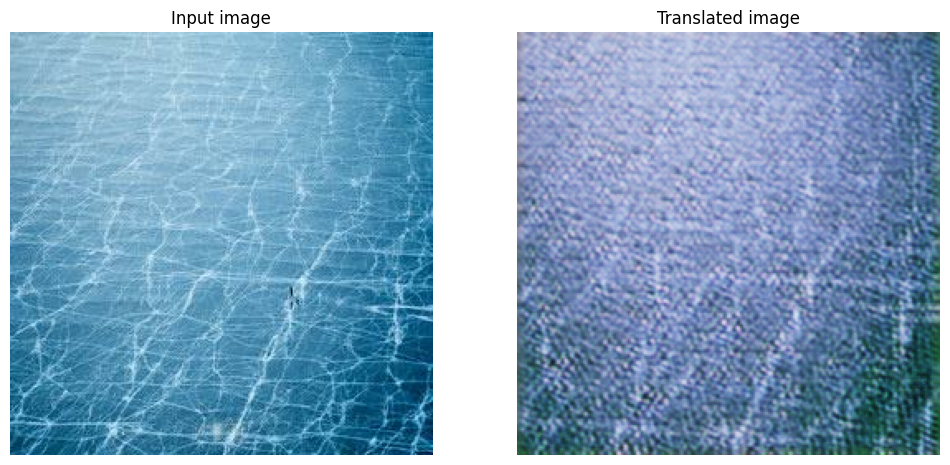

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1486 - D_Y_loss: 0.1645 - F_loss: 2.7104 - G_loss: 2.7184
Epoch 21/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1467 - D_Y_loss: 0.1661 - F_loss: 2.7502 - G_loss: 2.7019

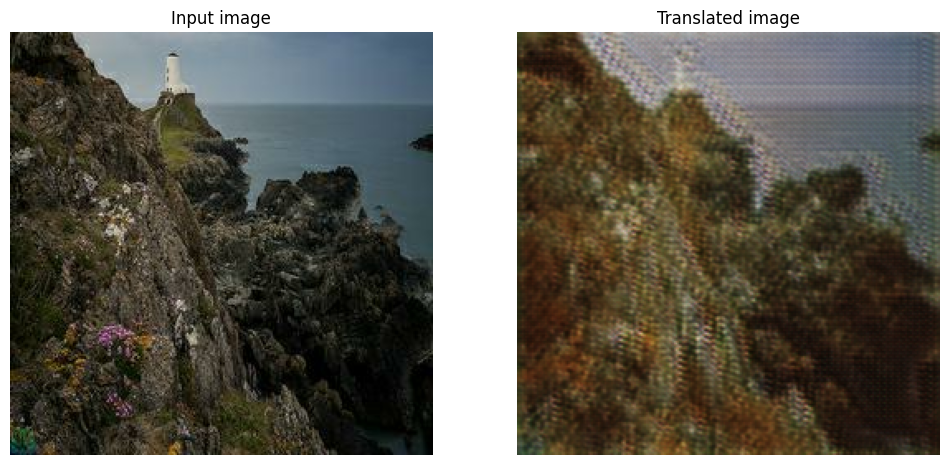

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 81ms/step - D_X_loss: 0.1472 - D_Y_loss: 0.1659 - F_loss: 2.7478 - G_loss: 2.7025
Epoch 22/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1538 - D_Y_loss: 0.1735 - F_loss: 2.7100 - G_loss: 2.6959

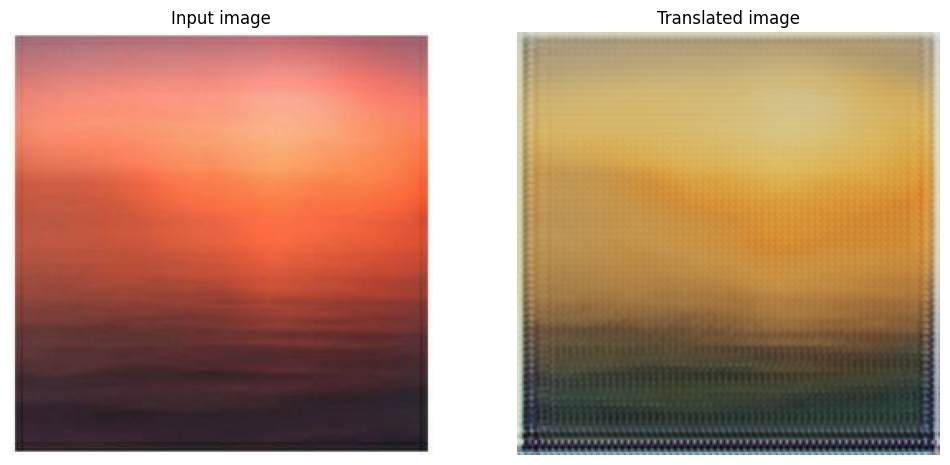

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1546 - D_Y_loss: 0.1742 - F_loss: 2.7088 - G_loss: 2.6961
Epoch 23/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1683 - D_Y_loss: 0.1597 - F_loss: 2.6077 - G_loss: 2.6506

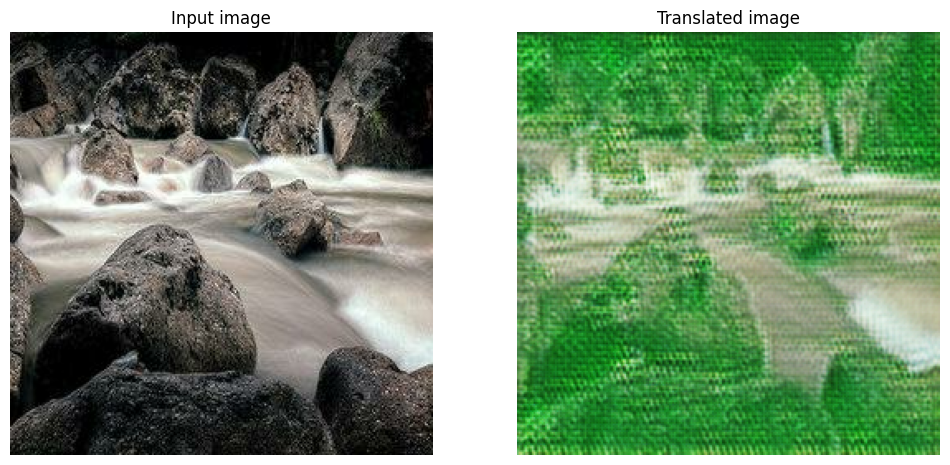

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 81ms/step - D_X_loss: 0.1679 - D_Y_loss: 0.1607 - F_loss: 2.6071 - G_loss: 2.6510
Epoch 24/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1749 - D_Y_loss: 0.1624 - F_loss: 2.6032 - G_loss: 2.6557

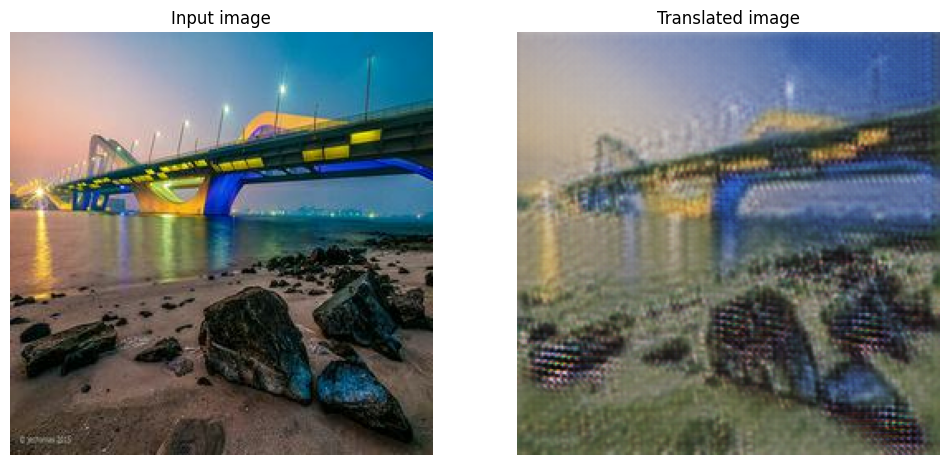

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1744 - D_Y_loss: 0.1620 - F_loss: 2.6060 - G_loss: 2.6536
Epoch 25/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1871 - D_Y_loss: 0.1792 - F_loss: 2.5533 - G_loss: 2.6083

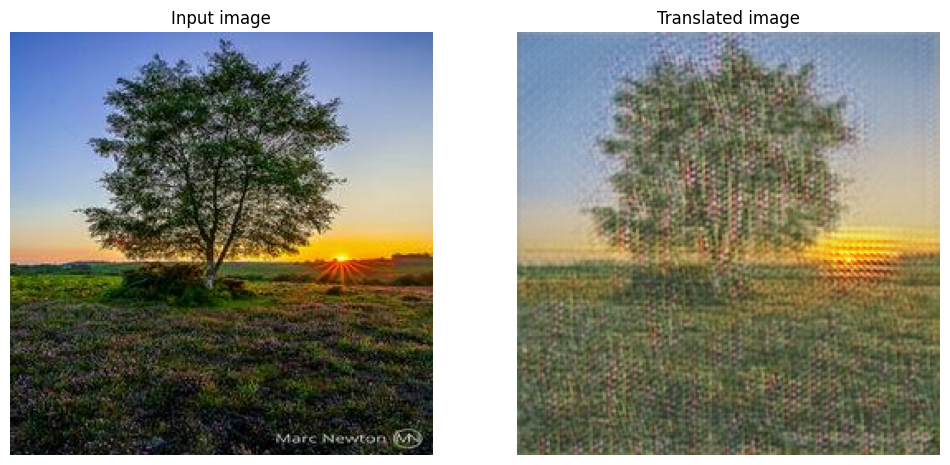

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1876 - D_Y_loss: 0.1799 - F_loss: 2.5511 - G_loss: 2.6082
Epoch 26/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1552 - D_Y_loss: 0.1848 - F_loss: 2.5800 - G_loss: 2.5345

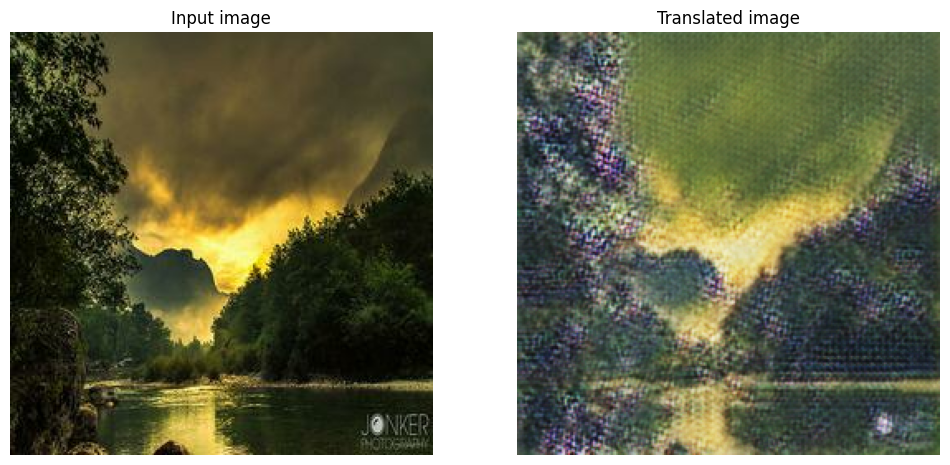

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1549 - D_Y_loss: 0.1857 - F_loss: 2.5824 - G_loss: 2.5330
Epoch 27/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1775 - D_Y_loss: 0.1865 - F_loss: 2.5405 - G_loss: 2.5099

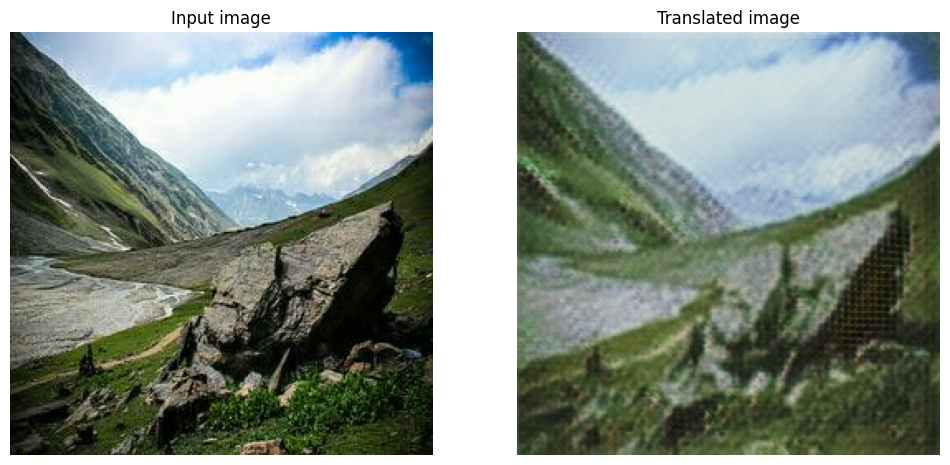

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 80ms/step - D_X_loss: 0.1770 - D_Y_loss: 0.1861 - F_loss: 2.5397 - G_loss: 2.5091
Epoch 28/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - D_X_loss: 0.1774 - D_Y_loss: 0.1970 - F_loss: 2.5243 - G_loss: 2.4674

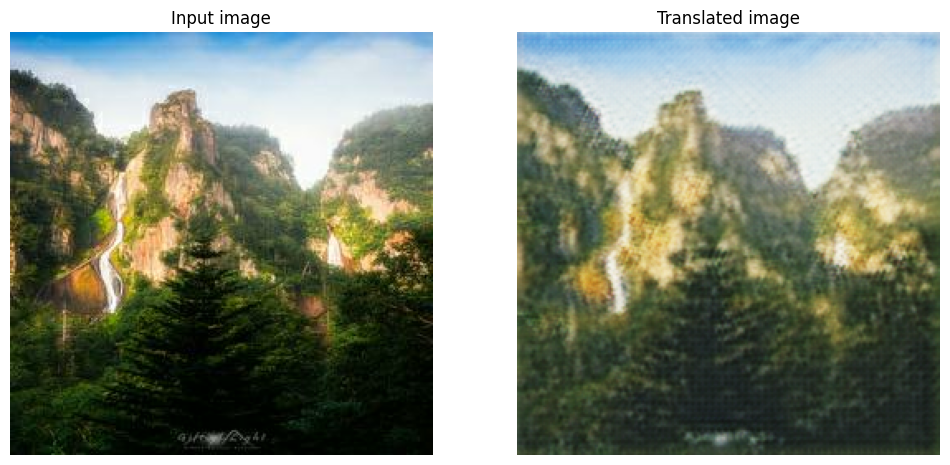

300/300 ━━━━━━━━━━━━━━━━━━━━ 24s 79ms/step - D_X_loss: 0.1796 - D_Y_loss: 0.1975 - F_loss: 2.5205 - G_loss: 2.4679
Epoch 29/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1945 - D_Y_loss: 0.2065 - F_loss: 2.5265 - G_loss: 2.4385

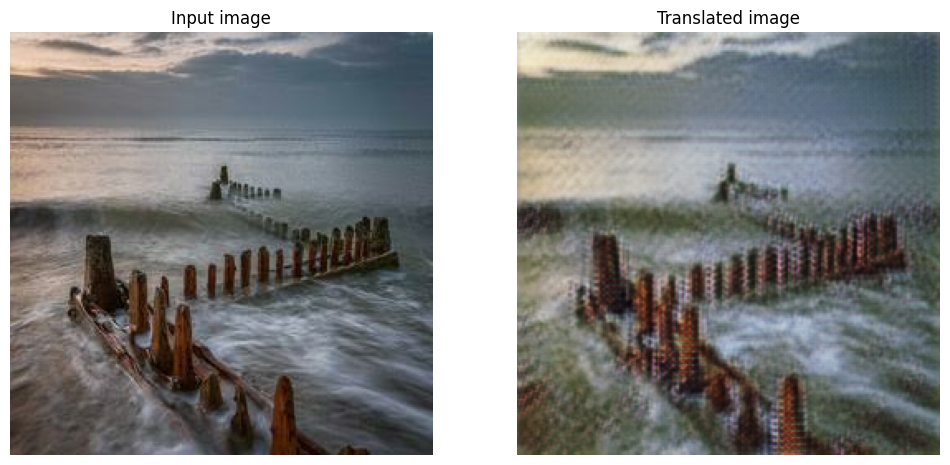

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 80ms/step - D_X_loss: 0.1941 - D_Y_loss: 0.2065 - F_loss: 2.5261 - G_loss: 2.4365
Epoch 30/30
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step - D_X_loss: 0.1743 - D_Y_loss: 0.2093 - F_loss: 2.5112 - G_loss: 2.4145

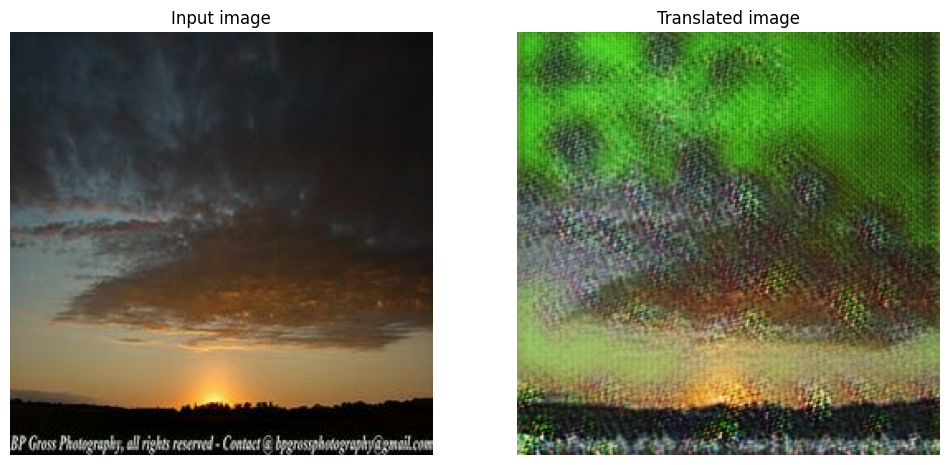

300/300 ━━━━━━━━━━━━━━━━━━━━ 25s 81ms/step - D_X_loss: 0.1738 - D_Y_loss: 0.2094 - F_loss: 2.5108 - G_loss: 2.4133


In [22]:
# Create cycle gan model
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)

# Compile the model
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Instantiate callbacks
plotter = GANMonitor(1)
checkpoint_filepath = "./model_checkpoints/cyclegan_checkpoints.weights.h5"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath, save_weights_only=True
)

# Train the model
cycle_gan_model.fit(
    tf.data.Dataset.zip((photo_ds, monet_ds)),
    epochs=30,
    callbacks=[plotter, model_checkpoint_callback],
)

Using the fully trained model, we translate each photo in the data set into a monet image and save the result as a ZIP file.

In [23]:
zip_filename = "/kaggle/working/images.zip"
count = 0
with zipfile.ZipFile(zip_filename, "w", compression=zipfile.ZIP_DEFLATED) as output:
    for photo in photo_ds:
        count += 1
        fake_monet = cycle_gan_model.gen_G(photo, training=False)
        fake_monet = (fake_monet[0] * 0.5 + 0.5)
        fake_monet = tf.clip_by_value(fake_monet, 0, 1)
        fake_monet = (fake_monet * 255).numpy().astype(np.uint8)
        img = Image.fromarray(fake_monet)
        img.save("/kaggle/working/img.jpg")
        filename = f"monet_{count}.jpg"
        output.write("/kaggle/working/img.jpg", arcname=filename)

# Hyperparameter tuning

We tested three iterations of our model in order to observe how `num_filters` (the number of generator and discriminator filters) affected this performance metric. Because the Kaggle scorer can only process one output image set per notebook, we ran three versions of the current notebook. We discuss the results of the hyperparameter tuning in "Results and analysis."

# GAN model building

Previously, we trained a CycleGAN to translate photos into images resembling Monet. We also implemented the simpler generative adversarial network following the tutorial at
[https://keras.io/examples/generative/dcgan_overriding_train_step/](https://keras.io/examples/generative/dcgan_overriding_train_step/). This GAN has a single generator that attempts to transform a random vector into a Monet-like image and a single discriminator that attempts to distinguish between generated and authentic images. Unfortunately, the results after a 30-epoch training cycle are not as good. Below are a couple examples of the images produced.

![GAN image 1](https://github.com/mattjanko/photo-to-monet/blob/main/GAN_output_1.jpg?raw=true)
![GAN image 2](https://github.com/mattjanko/photo-to-monet/blob/main/GAN_output_2.jpg?raw=true)


# Results and analysis

As part of the Kaggle competition from which our data originated, we can obtain a memorization-informed Fréchet inception distance score (MiFID) from the output ZIP file. MiFID scores are the metric according to which the competition is judged, with lower scores indicating higher-performing models. The plots below show MiFID scores and run times with `num_filters` set to 16, 32, and 64.

![MiFID scores](https://github.com/mattjanko/photo-to-monet/blob/main/MiFIDs.png?raw=true)

![Runtimes](https://github.com/mattjanko/photo-to-monet/blob/main/runtimes.png?raw=true)

Our best score was 71.56904, which placed 41st out of 106 entries as of April 8, 2025.

![Leaderboard](https://github.com/mattjanko/photo-to-monet/blob/97886092bacc7d1c11bd32cc1f8dca9847dc2adc/leaderboard.png?raw=true)

MiFID scores quantify our model's ability to translate photos into Monet-style images, but another consideration is a user's subjective impression about whether a translated image resembles a Monet painting. The following pairs of images show a photo from the training set and the translated Monet-style image generated by the CycleGAN with `num_filters` set to 64.

![Pair 1, 64 filters](https://github.com/mattjanko/photo-to-monet/blob/dd1f422eb2bd6beccdebe423a0787f6cbefe11da/64_1.png?raw=true)

![Pair 2, 64 filters](https://github.com/mattjanko/photo-to-monet/blob/dd1f422eb2bd6beccdebe423a0787f6cbefe11da/64_2.png?raw=true)

When `num_filters` was set to 16, we obtained the following image pairs instead.

![Pair 1, 16 filters](https://github.com/mattjanko/photo-to-monet/blob/dd1f422eb2bd6beccdebe423a0787f6cbefe11da/16_1.png?raw=true)

![Pair 2, 16 filters](https://github.com/mattjanko/photo-to-monet/blob/dd1f422eb2bd6beccdebe423a0787f6cbefe11da/16_2.png?raw=true)

None of the generated images is a particularly good approximation of a Monet paintings. However, when we consider the images subjectively, the images produced with only 16 filters do not seem obviously inferior to the images produced with 64 filters, and training the mdoel is much faster with 16 filters instead of 64.

Our generic GAN with a single generator-discriminator pair received an MiFID score of 294.89805, by far the worst result. A likely problem confronting the generic GAN is that it needs to generate both the subject of the image (e.g., a tree, a house, a bridge) as well as the visual elements to render it. In order to let the model to learn both the subjects and ways to represent them, we probably need to expose the GAN to more training images of actual Monet paintings than the 300 scans available. We might consider augmenting our data set by random flipping, scaling, and cropping the scans that we have.

# Conclusion

Our project demonstrated that a deep learning model with a CycleGAN architecture can successfully learn to generate Monet-style images from photos. We also saw that CycleGAN performance as measured by MiFID is sensitive to changes in the number of filters in the model's generators and discriminators, although the relationship between the number of filters and model performance may be complicated. Among the iterations of our model that we tested, the best MiFID was obtained from the generator with the most filters, and the second-best MiFID came from the generator with the least filters. Moreover, both generators produced images that, at least subjectively, seemed to be similarly good approximations of Monet paintings.

The generic GAN did not produce images that resembled Monet paintings, and it had the worst MiFID score observed in the project. Most likely, the problem was a lack of training data. With more training images, the GAN might be more able to learn about the possible subjects characteristic of Monet paintings as well as suitable visual representations. Additional Monet images in the training set could also improve CycleGAN performance.

Both the CycleGAN and the generic GAN could also benefit from training cycles with more epochs. We saw that generators with as few as 16 filters can create imperfect approximations of Monet paintings. Therefore, we think the best way to continue developing this model would be to conduct longer training cycles, possibly on augmented data obtained from random flipping, scaling, and cropping of scans of Monet paintings already in the training set.

# References

1. [CycleGAN](https://keras.io/examples/generative/cyclegan/)
2. [DCGAN to generate face images](https://keras.io/examples/generative/dcgan_overriding_train_step/)